In [2]:
using DifferentialEquations, SparseArrays, LinearAlgebra, Random, Plots

# define parameters
KS_params = (0.1, 1.0, 5.0, 0.1)
# reparameterize(KS_params)

# get initial conditions

# set up problem 

# solve problem

(0.1, 1.0, 5.0, 0.1)

In [3]:
# utility functions 
function reparameterize(KS_params)
    mass = sqrt(12 * KS_params[1] * KS_params[2] / KS_params[3])
    kappa = 1 / (1 / 4 / sqrt(KS_params[2]) + 1 / mass / KS_params[3])
    k = 1 / sqrt(KS_params[2]) 
    eps = 4 * KS_params[4] * exp(-KS_params[3] * mass / 2 / KS_params[1] / sqrt(KS_params[2]))
    return (kappa, k, eps)
end

function find_neighbors(index, laplacian::SparseMatrixCSC)
    # Use sparse matrix utilities to find non-zero entries in the row
    # neighbors = findnz(laplacian[index, :])[1]
    neighbors = findall(x -> x == 1, laplacian[index, :])
    return neighbors
end

mutable struct TriggerIndex
    index::Int
end

function split!(split_index, u, laplacian)
    # Find a neighbor
    neighbors = find_neighbors(split_index, laplacian)
    if isempty(neighbors)
        error("Split index has no neighbors!")
    end
    neighbor = neighbors[1]

    # Find a new empty spot
    new_index = findfirst(x -> x < 0.0, u)
    if new_index === nothing
        error("No empty spot available for splitting!")
    end

    # Update adjacency matrix
    laplacian[split_index, neighbor] = 0.0
    laplacian[neighbor, split_index] = 0.0

    laplacian[split_index, new_index] = 1.0
    laplacian[new_index, split_index] = 1.0

    laplacian[neighbor, new_index] = 1.0
    laplacian[new_index, neighbor] = 1.0

    laplacian[new_index, new_index] = -2.0

    # Split the value
    split_val = u[split_index]
    u[split_index] = split_val / 2  # Halve the value
    u[new_index] = split_val / 2    # Assign the other half to the new individual
    
    dropzeros!(laplacian)
end

# Split queue elements
struct FloatIntPair
    float::Float64
    int::Int
end

# Insert a new pair, keeping it sorted
function insert_pair!(pairs::Vector{FloatIntPair}, float_val::Float64, int_val::Int)
    push!(pairs, FloatIntPair(float_val, int_val))
    sort!(pairs, by = x -> x.float)  # Sort by float value
end

# Remove the smallest pair
function remove_smallest!(pairs::Vector{FloatIntPair})
    isempty(pairs) && throw(ArgumentError("No pairs to remove"))
    popfirst!(pairs)
end

function get_split_time(u, laplacian, index)
    derivative = dydt()###

    return sqrt(-2 / r / derivative * log(rand(rng)))
end

get_split_time (generic function with 1 method)

In [4]:
# callback functions

function merge_condition(u, t, integrator)
    merge_threshold = integrator.p.merge_threshold
    # Compute the minimum value ignoring zeros
    min_value, min_index = findmin(x -> x > 0.0 ? x : Inf, u)
    # Update the merge_trigger index
    integrator.p.merge_trigger.index = min_index
    # Return the difference for the root-finding logic
    return min_value - merge_threshold
end

function merge_affect!(integrator)
    # determine where merge happened
    # merge_index = find_merge_index(integrator.u)
    merge_index = integrator.p.merge_trigger.index
    # find its neighbors
    neighbors = find_neighbors(merge_index, integrator.p.laplacian)
    
    # change laplacian and state vector
    for neighbor in neighbors
        integrator.u[neighbor] += integrator.u[merge_index]/2  # Distribute the value to neighbors
        # Remove connections to merge_index
        integrator.p.laplacian[merge_index, neighbor] = 0.0
        integrator.p.laplacian[neighbor, merge_index] = 0.0
    end
    integrator.u[merge_index] = -1.0  # Mark the merged individual with 0.0
    integrator.p.laplacian[merge_index, merge_index] = 0.0 # kill the diagonal

    # Connect the neighbors directly
    integrator.p.laplacian[neighbors[1], neighbors[2]] = 1.0
    integrator.p.laplacian[neighbors[2], neighbors[1]] = 1.0

    dropzeros!(integrator.p.laplacian)
    
    # check if it crossed the splitting threshold, split
    for neighbor in neighbors
        if integrator.u[neighbor] > integrator.p.hard_split_threshold
            split!(neighbor, integrator.u, integrator.p.laplacian)
        elseif (integrator.u[neighbor] > integrator.p.split_threshold) && (neighbor ∉ [a.int for a in integrator.p.split_queue])
            split_affect!(integrator, neighbor)
        end
    end
end

function hard_split_condition(u, t, integrator)
    hard_split_threshold = integrator.p.hard_split_threshold
    # Compute the maximum value
    max_value, max_index = findmax(u)
    # Update the hard_split_trigger index
    integrator.p.hard_split_trigger.index = max_index
    # Return the difference 
    return max_value - hard_split_threshold 
end

function hard_split_affect!(integrator)
    # determine where hard split happened
    # hard_split_index = find_hard_split_index(integrator.u)
    hard_split_index = integrator.p.hard_split_trigger.index
    # split
    split!(hard_split_index, integrator.u, integrator.p.laplacian)
end

function split_condition(out, u, t, integrator)
    out .= u .- integrator.p.split_threshold
end

function split_affect!(integrator, idx)
    # choose a split time
    derivative = dydt(integrator.u, integrator.p, integrator.t)[idx]
    split_time = sqrt(-2 / integrator.p.split_rate / derivative * log(rand(integrator.p.rng)))
    # append idx and new split time to split queue 
    insert_pair!(integrator.p.split_queue, integrator.t + split_time, idx)
end

function execute_split_condition(u, t, integrator)
    # next predicted splitting time
    split_time = integrator.p.split_queue[1].float
    return t - split_time
end

function execute_split_affect!(integrator)
    # get where we split
    split_data = remove_smallest!(integrator.p.split_queue)
    # split_time = split_data.float
    split_index = split_data.int

    # split
    split!(split_index, integrator.u, integrator.p.laplacian)
end

nmax = 8
merge_cb = ContinuousCallback(merge_condition, nothing, merge_affect!; abstol=1e-3)
hardsplit_cb = ContinuousCallback(hard_split_condition, hard_split_affect!, nothing; abstol=1e-3)
split_detect_cb = VectorContinuousCallback(split_condition, split_affect!, nothing, nmax; abstol=1e-3)
split_execute_cb = ContinuousCallback(execute_split_condition, execute_split_affect!, nothing; abstol=1e-3)
cbs = CallbackSet(merge_cb, split_detect_cb, split_execute_cb, hardsplit_cb)
# cbs = CallbackSet(merge_cb, split_detect_cb, split_execute_cb)

CallbackSet{Tuple{ContinuousCallback{typeof(merge_condition), Nothing, typeof(merge_affect!), typeof(SciMLBase.INITIALIZE_DEFAULT), typeof(SciMLBase.FINALIZE_DEFAULT), Float64, Int64, Rational{Int64}, Nothing, Nothing, Int64}, VectorContinuousCallback{typeof(split_condition), typeof(split_affect!), Nothing, typeof(SciMLBase.INITIALIZE_DEFAULT), typeof(SciMLBase.FINALIZE_DEFAULT), Float64, Int64, Rational{Int64}, Nothing, Nothing, Int64}, ContinuousCallback{typeof(execute_split_condition), typeof(execute_split_affect!), Nothing, typeof(SciMLBase.INITIALIZE_DEFAULT), typeof(SciMLBase.FINALIZE_DEFAULT), Float64, Int64, Rational{Int64}, Nothing, Nothing, Int64}, ContinuousCallback{typeof(hard_split_condition), typeof(hard_split_affect!), Nothing, typeof(SciMLBase.INITIALIZE_DEFAULT), typeof(SciMLBase.FINALIZE_DEFAULT), Float64, Int64, Rational{Int64}, Nothing, Nothing, Int64}}, Tuple{}}((ContinuousCallback{typeof(merge_condition), Nothing, typeof(merge_affect!), typeof(SciMLBase.INITIALIZE

In [5]:
# right hand side
function dydt!(du, u, p, t)
    kappa, k, eps = p.sip_params
    gu = 0.5 * kappa .* exp.(-k .* u) .+ 0.5 * eps .* u
    du .= p.laplacian * gu
end

function dydt(u, p, t)
    kappa, k, eps = p.sip_params
    gu = 0.5 * kappa .* exp.(-k .* u) .+ 0.5 * eps .* u
    return p.laplacian * gu
end

function jac_dydt!(J, u, p, t)
    kappa, k, eps = p.sip_params
    dgu = -k * 0.5 * kappa .* exp.(-k .* u) .+ 0.5 * eps
    J .= p.laplacian * Diagonal(dgu)
end


jac_dydt! (generic function with 1 method)

In [6]:
# initials
function get_initials_gauss(;size=100, L_full=100.0, mean=10.0, sigma=1.0, seed=0)
    u0 = mean .+ sigma .* randn(Xoshiro(seed), size)

    cumsum_lbd = cumsum(u0)
    too_big_inds = findall(x -> x > L_full, cumsum_lbd)

    if !isempty(too_big_inds)
        u0[too_big_inds] .= 0.0
        u0[first(too_big_inds)] = L_full - sum(u0)
    end

    u0[u0 .== 0.0] .= -1.0

    return u0
end

function create_laplacian_periodic_1d(size::Int)
    laplacian = zeros(size, size)
    for i in 1:size
        laplacian[i, i] = -2.0
    end
    for i in 1:size-1
        laplacian[i, i+1] = 1.0
        laplacian[i+1, i] = 1.0
    end
    laplacian[1, end] = 1.0
    laplacian[end, 1] = 1.0
    return laplacian
end

function get_laplacian(nmax::Int, active_size::Int)
    full_matrix = zeros(Float64, nmax, nmax)
    full_matrix[1:active_size, 1:active_size] = create_laplacian_periodic_1d(active_size)
    return full_matrix
end



get_laplacian (generic function with 1 method)

In [7]:
# parameters struct
struct SIPparameter
    laplacian::SparseMatrixCSC
    split_queue::Vector{FloatIntPair}
    sip_params::Tuple{Float64, Float64, Float64}
    merge_threshold::Float64
    split_threshold::Float64
    hard_split_threshold::Float64
    merge_trigger::TriggerIndex
    hard_split_trigger::TriggerIndex
    split_rate::Float64
    rng::MersenneTwister

    # Inner constructor with mandatory keyword arguments
    function SIPparameter(; 
        laplacian::SparseMatrixCSC,
        split_queue::Vector{FloatIntPair},
        sip_params::Tuple{Float64, Float64, Float64},
        merge_threshold::Float64,
        split_threshold::Float64,
        hard_split_threshold::Float64,
        merge_trigger::TriggerIndex,
        hard_split_trigger::TriggerIndex,
        split_rate::Float64,
        rng::MersenneTwister
    )
        new(
            laplacian, 
            split_queue, 
            sip_params, 
            merge_threshold, 
            split_threshold, 
            hard_split_threshold, 
            merge_trigger, 
            hard_split_trigger, 
            split_rate, 
            rng
        )
    end
end


In [13]:
nmax = 8
u0 = get_initials_gauss(size=nmax, L_full=44.0, mean=13.5, sigma=0.5, seed=0)
laplacian_ini = SparseMatrixCSC(get_laplacian(nmax, count(x -> x > 0, u0)))

t_final = 1e7
seed = 0

p = SIPparameter(
        laplacian=laplacian_ini,
        split_queue=[FloatIntPair(t_final+1.0, 0)],
        sip_params=reparameterize(KS_params),
        merge_threshold=1e-1,
        split_threshold=15.0,
        hard_split_threshold=20.0,
        merge_trigger=TriggerIndex(0),
        hard_split_trigger=TriggerIndex(0),
        split_rate=1e-2,
        rng=MersenneTwister(seed)
    )
rhs! = ODEFunction(dydt!, jac=jac_dydt!)
prob = ODEProblem(rhs!, u0, (0, t_final), p)
# prob = ODEProblem(dydt!, u0, (0, 35.0), p)


ODEProblem with uType Vector{Float64} and tType Float64. In-place: true
timespan: (0.0, 1.0e7)
u0: 8-element Vector{Float64}:
 13.384045465211525
 13.970195105124297
 13.79838083556676
  2.847378594097421
 -1.0
 -1.0
 -1.0
 -1.0

In [14]:
sol = solve(prob, TRBDF2(), callback = cbs)

retcode: Success
Interpolation: 3rd order Hermite
t: 10759-element Vector{Float64}:
 0.0
 0.03007892999455737
 0.33086822994013104
 2.30746916937213
 3.1112042646947646
 5.4285048927285775
 6.338799640960282
 7.507309820418407
 8.675819999876532
 9.534568964815659
 ⋮
 6.221605555472588e6
 6.428515095363216e6
 6.861510817592089e6
 7.129022378104086e6
 7.721230198668004e6
 8.107307838401361e6
 8.985437630492577e6
 9.669209993812108e6
 1.0e7
u: 10759-element Vector{Vector{Float64}}:
 [13.384045465211525, 13.970195105124297, 13.79838083556676, 2.847378594097421, -1.0, -1.0, -1.0, -1.0]
 [13.385371965682806, 13.970195102519352, 13.799707335970679, 2.844725595827164, -1.0, -1.0, -1.0, -1.0]
 [13.398835034352444, 13.970195076445702, 13.813170402216839, 2.817799486985014, -1.0, -1.0, -1.0, -1.0]
 [13.497995635201296, 13.970194912845907, 13.912330904378122, 2.6194785475746762, -1.0, -1.0, -1.0, -1.0]
 [13.54459268086487, 13.970194854949602, 13.958927867089088, 2.5262845970964385, -1.0, -1.0, -1

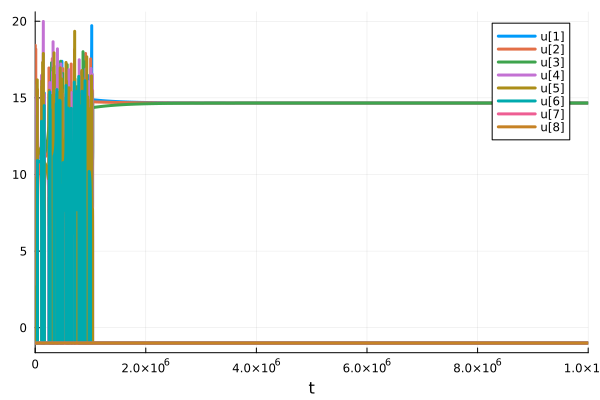

In [15]:
# plot(sol, tspan = (0.8875e5, 0.889e5), lw=3)
plot(sol, lw=3)

In [132]:
for i in 1:221
    println(sum(sol.u[i][sol.u[i] .> 0]))
    # println(sum(sol.u[i][2]))
end

45.0
45.0
45.0
45.00000000000001
45.00000000000001
45.0
45.00000000000001
45.00000000000001
45.00000000000001
45.0
45.000000000000014
45.000000000000014
45.00000000000001
45.00000000000001
45.00000000000001
45.000000000000014
45.00000000000001
45.00000000000001
45.000000000000014
45.00000000000001
45.00000000000001
45.0
44.99999999999996
44.99999999996817
45.00000000015654
45.00000000146542
44.99999994909003
45.000005199674966
45.00001072556212
45.00001072556212
45.00001072556212
45.00001072556213
45.00001072556212
45.00001072556212
45.00001072556212
45.00001072556212
45.00001072556211
45.00001072556211
45.00001072556212
45.00001072556211
45.00001072556213
45.00001072556213
45.00001072556211
45.00001072556211
45.00001072556211
45.00001072556212
45.00001072556212
45.00001072556211
45.00001072556212
45.00001072556213
45.00001072556212
45.00001072556212
45.00001072556212
45.00001072556212
45.00001072556212
45.00001072556213
45.00001072556212
45.00001072556212
45.00001072556212
45.00001072